<a href="nyc"><img src = "https://cdn0.tnwcdn.com/wp-content/blogs.dir/1/files/2013/09/nyc.jpg" width = 400> </a>

<h1 align=center><font size = 5>COVID-19 in New York City</font></h1>

## Introduction



## Table of Contents

<div class="alert alert-block alert-info" style="margin-top: 20px">
<font size = 3>
<li>1.<a href="#item1">Download New York City Datasets</a></li>
<li>2.<a href="#item2">Download Foursquare API Datasets</a></li>
<li>3.<a href="#item3">Analyze Each Neighborhood</a></li>
<li>4.<a href="#item4">Cluster Neighborhoods</a></li>
<li>5.<a href="#item5">Examine Clusters</a>    </li>
</font>
</div>

Before we get the data and start exploring it, let's download all the dependencies that we will need.

In [42]:
# library to handle data in a vectorized manner
import numpy as np 

# library for data analsysis
import pandas as pd 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# library to handle JSON files
import json 

# convert an address into latitude and longitude values
from geopy.geocoders import Nominatim 

# library to handle requests
import requests 
import warnings
warnings.filterwarnings('ignore', message='Unverified HTTPS request')

# tranform JSON file into a pandas dataframe
from pandas.io.json import json_normalize 

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

# map rendering library
import folium 

print('Libraries imported.')

Libraries imported.


In [43]:
foursquare_API = False
neighbourhood_data = False

# 1. Download New York City datasets

## 1.0 Load New-York City Zip Codes / Neighborhoods

References :
- https://www.health.ny.gov/statistics/cancer/registry/appendix/neighborhoods.htm
- https://github.com/MacHu-GWU/uszipcode-project

In [44]:
df_neighborhood = pd.read_excel('zipcodeNYC.xlsx')
df_neighborhood.columns = [ii.lower() for ii in df_neighborhood.columns]
df_neighborhood = df_neighborhood.rename(columns={'zipcode':'zip_code'})
# Strip spaces in zipcode string
df_neighborhood['zip_code']=df_neighborhood['zip_code'].astype('str').str.strip()
print(df_neighborhood.shape)
df_neighborhood.head()

(178, 6)


,borough,neighborhood,zip_code,latitude,longitude,landsqmi
0,Manhattan,Chelsea and Clinton,10001,40.750742,-73.996530,0.62
1,Manhattan,Lower East Side,10002,40.717040,-73.987000,0.88
2,Manhattan,Lower East Side,10003,40.732509,-73.989350,0.58
3,Manhattan,Lower Manhattan,10004,40.862612,-73.925379,0.56
4,Manhattan,Lower Manhattan,10005,40.706019,-74.008580,0.07


## 1.1 Load New-York City Demographic statistics

Source : http://www.city-data.com/

In [45]:
#Initialize
df_neighborhood['density']=np.nan
df_neighborhood['median_house_value']=np.nan
df_neighborhood['median_age']=np.nan
df_neighborhood['avg_household_size']=np.nan
df_neighborhood['avg_agi']=np.nan
df_neighborhood['avg_wage']=np.nan

In [46]:
if neighbourhood_data:
    for ii in range(df_neighborhood.shape[0]):
        
        # Zip Code
        zipcode=str(df_neighborhood['zip_code'].iloc[ii])
        
        
        print('-----')
        print(zipcode)
            
        # Parse HTML data from website 
        data = pd.DataFrame(pd.read_html(r'http://www.city-data.com/zips/'+zipcode+'.html'))
        
        try:
            
            density = int(str(data.iloc[8,0][0]).split('density: ')[1].split(' people')[0].replace(',',''))
            median_house_value = int(str(data.iloc[13,0][1][0]).split('$')[1].replace(',',''))
            median_age = float(str(data.iloc[14,0][1][0]).split(' years')[0])
            avg_household_size = float(str(data.iloc[15,0][1][0]).split(' people')[0])
            avg_agi = int(str(data.iloc[16,0][1][0]).replace(',','').replace('$',''))
            avg_wage = int(str(data.iloc[17,0][1][0]).replace(',','').replace('$',''))

            #Save data in the dataframe
            df_neighborhood['density'].iloc[ii]=density
            df_neighborhood['median_house_value'].iloc[ii]=median_house_value
            df_neighborhood['median_age'].iloc[ii]=median_age
            df_neighborhood['avg_household_size'].iloc[ii]=avg_household_size
            df_neighborhood['avg_agi'].iloc[ii]=avg_agi
            df_neighborhood['avg_wage'].iloc[ii]=avg_wage
            
       
        except :
            print('--ERROR--')
         
    
    # Export Data
    df_neighborhood.to_csv('data_neighborhood.csv',sep=';')

In [47]:
df_neighborhood = pd.read_csv('data_neighborhood.csv',sep=';', index_col=0)
df_neighborhood['zip_code']=df_neighborhood['zip_code'].astype('str').str.strip()
df_neighborhood.dtypes

borough                object
neighborhood           object
zip_code               object
latitude              float64
longitude             float64
landsqmi              float64
density               float64
median_house_value    float64
median_age            float64
avg_household_size    float64
avg_agi               float64
avg_wage              float64
dtype: object

In [48]:
df_neighborhood['total_population']=df_neighborhood['density']*df_neighborhood['landsqmi']
df_neighborhood['total_population']=df_neighborhood['total_population'].astype('float64')
df_neighborhood.head()

,borough,neighborhood,zip_code,latitude,longitude,landsqmi,density,median_house_value,median_age,avg_household_size,avg_agi,avg_wage,total_population
0,Manhattan,Chelsea and Clinton,10001,40.750742,-73.996530,0.62,39102.0,399889.0,35.6,1.9,144041.0,118909.0,24243.24
1,Manhattan,Lower East Side,10002,40.717040,-73.987000,0.88,89911.0,721285.0,42.1,2.3,44740.0,42766.0,79121.68
2,Manhattan,Lower East Side,10003,40.732509,-73.989350,0.58,96874.0,1108917.0,32.9,1.7,204008.0,148545.0,56186.92
3,Manhattan,Lower Manhattan,10004,40.862612,-73.925379,0.56,5419.0,1796465.0,35.9,1.9,363621.0,246647.0,3034.64
4,Manhattan,Lower Manhattan,10005,40.706019,-74.008580,0.07,119790.0,1680524.0,30.4,2.1,983554.0,215824.0,8385.30


In [49]:
# Drop rows containg blank cells
df_neighborhood=df_neighborhood.dropna(how ='any')
df_neighborhood.shape

(176, 13)

## 1.2 Load New-York City COVID-19 cases - by Zip Code

- Source : Github - https://github.com/nychealth/coronavirus-data
- Updated : every day

In [50]:
url_github_data='https://raw.githubusercontent.com/nychealth/coronavirus-data/master/tests-by-zcta.csv'
# Load data
df_covid19=pd.read_csv(url_github_data, index_col=0).reset_index()
# Rename columns
df_covid19=df_covid19.rename(columns={'MODZCTA':'zip_code','Positive':'nb_positive_covid19'})
# Drop unused columns and null zip codes
df_covid19=df_covid19[['zip_code','nb_positive_covid19']].dropna(subset=['zip_code'])
# Strip spaces in zipcode string
df_covid19['zip_code']=df_covid19['zip_code'].astype('int64').astype('str').str.strip()
print(df_covid19.shape)
df_covid19.head()

(177, 2)


,zip_code,nb_positive_covid19
1,10001,266
2,10002,729
3,10003,355
4,10004,26
5,10005,44


#### Merge with COVID-19 dataset, ignoring Neighborhoods without data

In [51]:
# Merge with demographic data - Inner join
df_data = pd.merge(df_neighborhood,df_covid19,on='zip_code',how='inner')
print(df_data.shape)
df_data.head()

(174, 14)


,borough,neighborhood,zip_code,latitude,longitude,landsqmi,density,median_house_value,median_age,avg_household_size,avg_agi,avg_wage,total_population,nb_positive_covid19
0,Manhattan,Chelsea and Clinton,10001,40.750742,-73.996530,0.62,39102.0,399889.0,35.6,1.9,144041.0,118909.0,24243.24,266
1,Manhattan,Lower East Side,10002,40.717040,-73.987000,0.88,89911.0,721285.0,42.1,2.3,44740.0,42766.0,79121.68,729
2,Manhattan,Lower East Side,10003,40.732509,-73.989350,0.58,96874.0,1108917.0,32.9,1.7,204008.0,148545.0,56186.92,355
3,Manhattan,Lower Manhattan,10004,40.862612,-73.925379,0.56,5419.0,1796465.0,35.9,1.9,363621.0,246647.0,3034.64,26
4,Manhattan,Lower Manhattan,10005,40.706019,-74.008580,0.07,119790.0,1680524.0,30.4,2.1,983554.0,215824.0,8385.30,44


In [52]:
# Calculate %_pop_positive_covid19
df_data['perc_pop_positive_covid19'] = df_data['nb_positive_covid19']/df_data['total_population']
df_data.head()

,borough,neighborhood,zip_code,latitude,longitude,landsqmi,density,median_house_value,median_age,avg_household_size,avg_agi,avg_wage,total_population,nb_positive_covid19,perc_pop_positive_covid19
0,Manhattan,Chelsea and Clinton,10001,40.750742,-73.996530,0.62,39102.0,399889.0,35.6,1.9,144041.0,118909.0,24243.24,266,0.010972
1,Manhattan,Lower East Side,10002,40.717040,-73.987000,0.88,89911.0,721285.0,42.1,2.3,44740.0,42766.0,79121.68,729,0.009214
2,Manhattan,Lower East Side,10003,40.732509,-73.989350,0.58,96874.0,1108917.0,32.9,1.7,204008.0,148545.0,56186.92,355,0.006318
3,Manhattan,Lower Manhattan,10004,40.862612,-73.925379,0.56,5419.0,1796465.0,35.9,1.9,363621.0,246647.0,3034.64,26,0.008568
4,Manhattan,Lower Manhattan,10005,40.706019,-74.008580,0.07,119790.0,1680524.0,30.4,2.1,983554.0,215824.0,8385.30,44,0.005247


## 1.3 Download New-York City map with Zip Codes

Source : https://geo.nyu.edu/catalog/harvard-tg00nyzcta

In [53]:
with open('nyzcta-geojson.json') as json_data:
    newyork_data = json.load(json_data)

## 1.4 Vizualize the number of people tested positive for COVID-19

#### Use geopy library to get the latitude and longitude values of New York City.

In order to define an instance of the geocoder, we need to define a user_agent. We will name our agent <em>ny_explorer</em>, as shown below.

In [54]:
address = 'New York City, NY'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of New York City are 40.7127281, -74.0060152.


In [55]:
# create a NYC map
NYC_map = folium.Map(location=[latitude, longitude], zoom_start=10)

In [ ]:
# generate choropleth map using the total immigration of each country to Canada from 1980 to 2013
folium.Choropleth(
    geo_data=newyork_data,
    data=df_data,
    columns=['zip_code', 'perc_pop_positive_covid19'],
    key_on='feature.properties.ZCTA',
    fill_color='YlOrRd', 
    nan_fill_color ='#e7dddd',
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='People tested positive for COVID-19 in New-York City'
).add_to(NYC_map)

# display map
NYC_map

# 2. Download Foursquare API datasets

#### Define Foursquare Credentials and Version

In [ ]:
if foursquare_API :
    CLIENT_ID = 'AKC0LB0R50HQDF5ZJNKXKADAVJDRVJLKSOOOUT3GLWMIVRHM' # your Foursquare ID
    CLIENT_SECRET = '4JYPUHE2U5TZBMO0ULPBP22A53NFHO32MQFSCVKN0AYECMM2' # your Foursquare Secret
    VERSION = '20200301'

    print('Your credentails:')
    print('CLIENT_ID: ' + CLIENT_ID)
    print('CLIENT_SECRET:' + CLIENT_SECRET)

#### Search for specific venue categories - 500m
> `https://api.foursquare.com/v2/venues/`**search**`?client_id=`**CLIENT_ID**`&client_secret=`**CLIENT_SECRET**`&ll=`**LATITUDE**`,`**LONGITUDE**`&v=`**VERSION**`&query=`**QUERY**`&radius=`**RADIUS**`&limit=`**LIMIT**

**Categories** that will be counted :
- **Medical center** :  '4bf58dd8d48988d104941735,'
- **Arts & Entertainment** : '4d4b7104d754a06370d81259'
- **Nightlife spot** : '4d4b7105d754a06376d81259'
- **Outdoors & Recreation** : '4d4b7105d754a06377d81259'
- **Shop & Service** : '4d4b7105d754a06378d81259'
- **Food **:'4d4b7105d754a06374d81259'

In [ ]:
if foursquare_API :
    category_id = ['4bf58dd8d48988d104941735','4d4b7104d754a06370d81259','4d4b7105d754a06376d81259','4d4b7105d754a06377d81259',\
                 '4d4b7105d754a06378d81259','4d4b7105d754a06374d81259']
    category_name =  ['medical_center','arts_entertainment','nightlife_spot','outdoors_recreation','shop_service','food']

    # Initialize
    df_foursquare_API = pd.DataFrame()
    df_foursquare_API=df_data.copy()
    for label in category_name:
        df_foursquare_API[label]=np.nan
    df_foursquare_API.head()

In [ ]:
def get_foursquare_API_data(df, categoryId, categoryName, zipcode):

    # Parameters
    radius = 500
    LIMIT = 100
    # Serach for a Specific Category
    search_query = categoryId
    # Get zip_code latitude/longitude
    latitude = df.loc[zipcode,'latitude']
    longitude = df.loc[zipcode,'longitude']

    # Build the URL
    url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&categoryId={}&radius={}&limit={}'\
    .format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, search_query, radius, LIMIT)

    # Send the GET request
    results = requests.get(url,verify=False).json()

    # assign relevant part of JSON to venues
    venues = results['response']['venues']

    # tranform venues into a dataframe
    dataframe = pd.json_normalize(venues)

    df[categoryName].loc[zipcode] = dataframe.shape[0]
    
    return df

*You need an upgraded Foursquare account to run this function*

In [ ]:
if foursquare_API :
    for ii in range(len(category_id)):
        for jj in range(df_data.shape[0]):
            try :
                print('-----')
                print('ii :',ii,' jj : ',jj)
                df_foursquare_API = get_foursquare_API_data(df_foursquare_API, category_id[ii], category_name[ii], jj)
                if foursquare_API :
                    df_foursquare_API.to_csv('data_nyc.csv',sep=';')
                print(df_foursquare_API.iloc[jj,:])
            except :
                print(ii)
                print(jj)
                break

    df_foursquare_API.head()

# 3. Data Preparation

### Data exploration

In [ ]:
# Load data
df_data = pd.read_csv('data_nyc.csv',sep=';', index_col=0)
df_data.head()

,borough,neighborhood,zip_code,latitude,longitude,landsqmi,density,median_house_value,median_age,avg_household_size,avg_agi,avg_wage,total_population,nb_positive_covid19,perc_pop_positive_covid19,medical_center,arts_entertainment,nightlife_spot,outdoors_recreation,shop_service,food
0,Manhattan,Chelsea and Clinton,10001,40.750742,-73.996530,0.62,39102.0,399889.0,35.6,1.9,144041.0,118909.0,24243.24,266,0.010972,38.0,46.0,50.0,49.0,50.0,50.0
1,Manhattan,Lower East Side,10002,40.717040,-73.987000,0.88,89911.0,721285.0,42.1,2.3,44740.0,42766.0,79121.68,729,0.009214,42.0,50.0,50.0,48.0,50.0,50.0
2,Manhattan,Lower East Side,10003,40.732509,-73.989350,0.58,96874.0,1108917.0,32.9,1.7,204008.0,148545.0,56186.92,355,0.006318,50.0,48.0,50.0,48.0,50.0,50.0
3,Manhattan,Lower Manhattan,10004,40.862612,-73.925379,0.56,5419.0,1796465.0,35.9,1.9,363621.0,246647.0,3034.64,26,0.008568,33.0,25.0,48.0,35.0,48.0,50.0
4,Manhattan,Lower Manhattan,10005,40.706019,-74.008580,0.07,119790.0,1680524.0,30.4,2.1,983554.0,215824.0,8385.30,44,0.005247,40.0,47.0,50.0,48.0,50.0,50.0


In [ ]:
print('The dataframe has {} boroughs and {} neighborhoods.'.format(
        len(df_data['borough'].unique()),
        df_data.shape[0]
    )
)

The dataframe has 5 boroughs and 174 neighborhoods.


In [ ]:
df_data.dtypes

borough                       object
neighborhood                  object
zip_code                       int64
latitude                     float64
longitude                    float64
landsqmi                     float64
density                      float64
median_house_value           float64
median_age                   float64
avg_household_size           float64
avg_agi                      float64
avg_wage                     float64
total_population             float64
nb_positive_covid19            int64
perc_pop_positive_covid19    float64
medical_center               float64
arts_entertainment           float64
nightlife_spot               float64
outdoors_recreation          float64
shop_service                 float64
food                         float64
dtype: object

### Data preparation

#### Correlation analysis

In [ ]:
df_data[list(df_data.columns)[5:]].corr()

,landsqmi,density,median_house_value,median_age,avg_household_size,avg_agi,avg_wage,total_population,nb_positive_covid19,perc_pop_positive_covid19,medical_center,arts_entertainment,nightlife_spot,outdoors_recreation,shop_service,food
landsqmi,1.000000,-0.494558,-0.253764,0.216735,0.267451,-0.249127,-0.244903,0.281054,0.412303,0.339691,-0.287708,-0.406673,-0.398339,-0.412922,-0.474630,-0.390895
density,-0.494558,1.000000,0.309748,-0.311198,-0.375272,0.361101,0.311838,0.282072,0.018624,-0.455422,0.528892,0.588734,0.532870,0.590752,0.558689,0.530791
median_house_value,-0.253764,0.309748,1.000000,-0.014403,-0.494292,0.722998,0.807839,-0.162264,-0.409280,-0.636704,0.474339,0.644949,0.636302,0.538904,0.358372,0.355591
median_age,0.216735,-0.311198,-0.014403,1.000000,-0.183360,0.080430,0.174911,-0.300536,-0.234884,0.118199,-0.062477,-0.254004,-0.193682,-0.174903,-0.340547,-0.383325
avg_household_size,0.267451,-0.375272,-0.494292,-0.183360,1.000000,-0.566550,-0.651856,0.242082,0.461597,0.549147,-0.504572,-0.651032,-0.629487,-0.697578,-0.349660,-0.312544
avg_agi,-0.249127,0.361101,0.722998,0.080430,-0.566550,1.000000,0.897913,-0.303091,-0.402656,-0.450544,0.429838,0.531286,0.532421,0.444911,0.261187,0.217287
avg_wage,-0.244903,0.311838,0.807839,0.174911,-0.651856,0.897913,1.000000,-0.344144,-0.476217,-0.525695,0.482894,0.586502,0.597146,0.506236,0.270495,0.226792
total_population,0.281054,0.282072,-0.162264,-0.300536,0.242082,-0.303091,-0.344144,1.000000,0.828312,0.030969,0.130394,-0.052037,-0.048496,-0.022969,0.227421,0.259552
nb_positive_covid19,0.412303,0.018624,-0.409280,-0.234884,0.461597,-0.402656,-0.476217,0.828312,1.000000,0.503643,-0.143566,-0.369442,-0.355458,-0.331438,-0.039554,-0.028888
perc_pop_positive_covid19,0.339691,-0.455422,-0.636704,0.118199,0.549147,-0.450544,-0.525695,0.030969,0.503643,1.000000,-0.588693,-0.703230,-0.701066,-0.680360,-0.528957,-0.566061


#### Only keep useful columns

In [ ]:
# Only keep useful columns
list_cols = list(df_data.columns)
list_cols = list_cols[0:5]+list_cols[6:10]+[list_cols[11]]+list_cols[14:17]+list_cols[18:20]

# Create dataframe used for machine learning
df_ml = df_data.copy(deep=True)[list_cols]    


# Rename columns
for ii in range(11,len(list_cols)):
    list_cols[ii]='nb_venue_'+list_cols[ii]
df_ml.columns=list_cols
df_ml.head(100)

,borough,neighborhood,zip_code,latitude,longitude,density,median_house_value,median_age,avg_household_size,avg_wage,perc_pop_positive_covid19,nb_venue_medical_center,nb_venue_arts_entertainment,nb_venue_outdoors_recreation,nb_venue_shop_service
0,Manhattan,Chelsea and Clinton,10001,40.750742,-73.996530,39102.0,399889.0,35.6,1.9,118909.0,0.010972,38.0,46.0,49.0,50.0
1,Manhattan,Lower East Side,10002,40.717040,-73.987000,89911.0,721285.0,42.1,2.3,42766.0,0.009214,42.0,50.0,48.0,50.0
2,Manhattan,Lower East Side,10003,40.732509,-73.989350,96874.0,1108917.0,32.9,1.7,148545.0,0.006318,50.0,48.0,48.0,50.0
3,Manhattan,Lower Manhattan,10004,40.862612,-73.925379,5419.0,1796465.0,35.9,1.9,246647.0,0.008568,33.0,25.0,35.0,48.0
4,Manhattan,Lower Manhattan,10005,40.706019,-74.008580,119790.0,1680524.0,30.4,2.1,215824.0,0.005247,40.0,47.0,48.0,50.0
5,Manhattan,Lower Manhattan,10006,40.707904,-74.013420,39550.0,1124548.0,30.9,2.0,130297.0,0.004214,38.0,48.0,48.0,50.0
6,Manhattan,Lower Manhattan,10007,40.714754,-74.007210,43674.0,2249097.0,35.7,2.2,349986.0,0.006010,49.0,47.0,48.0,50.0
7,Manhattan,Lower East Side,10009,40.727093,-73.978640,98969.0,685637.0,37.1,2.0,63071.0,0.008637,35.0,44.0,48.0,50.0
8,Manhattan,Gramercy Park and Murray Hill,10010,40.739022,-73.982050,86020.0,846784.0,34.9,1.9,152989.0,0.006051,50.0,46.0,46.0,50.0
9,Manhattan,Chelsea and Clinton,10011,40.741012,-74.000120,78152.0,1100595.0,40.1,1.7,168767.0,0.007813,45.0,43.0,50.0,50.0


### Normalizing over the standard deviation
Now let's normalize the dataset. Normalization is a statistical method that helps mathematical-based algorithms to interpret features with different magnitudes and distributions equally. We use __StandardScaler()__ to normalize our dataset.

In [ ]:
from sklearn.preprocessing import StandardScaler
X = df_ml.values[:,5:]
X = np.nan_to_num(X)
Clus_dataSet = StandardScaler().fit_transform(X)
Clus_dataSet

C:\Users\c.lassus\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype object was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


array([[-0.20204325, -0.86891412, -0.43542212, ...,  1.63355124,
         1.45700318,  0.91182548],
       [ 1.37881417,  0.09338508,  0.96282438, ...,  1.86236019,
         1.39708388,  0.91182548],
       [ 1.59545906,  1.25400303, -1.01623221, ...,  1.74795571,
         1.39708388,  0.91182548],
       ...,
       [-1.01628952, -1.02042873,  0.25294539, ..., -0.94054943,
        -1.23936526, -3.64062187],
       [-0.93312253,  0.0634169 ,  2.53316277, ..., -0.88334719,
         0.07885931, -1.8971314 ],
       [-1.36600783, -0.19281417,  2.55467425, ..., -0.94054943,
        -0.76001087, -2.47829489]])

# 3. Cluster Neighbourhoods

#### Chose the right number of clusters - Elbow method and Silhouette score

A higher Silhouette Coefficient score relates to a model with better-defined clusters. The Silhouette Coefficient is defined for each sample and is composed of two scores: `

- a: The mean distance between a sample and all other points in the same class.
- b: The mean distance between a sample and all other points in the next nearest cluster.

The Silhouette Coefficient is for a single sample is then given as:
s=b-a/max(a,b)

In [ ]:
from sklearn.metrics import silhouette_score
sse={}
sil_coeff_x=[]
sil_coeff_y=[]

for k in range(1, 10):#
    kmeans = KMeans( init = "k-means++",n_clusters = k, n_init = 20, max_iter = 1000).fit(X)
    label = kmeans.labels_
    sse[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center
    if k>=2:
        sil_coeff_y.append(silhouette_score(X, label, metric='euclidean')) # Silhouette Coefficient 
        sil_coeff_x.append(k)

Text(0.5,1,'Elbow Criterion')

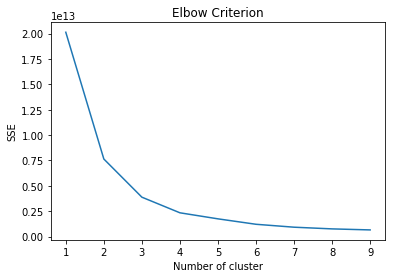

In [ ]:
import matplotlib.pyplot as plt
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")
plt.title("Elbow Criterion")

Text(0.5,1,'Silhouette Coefficient Criterion')

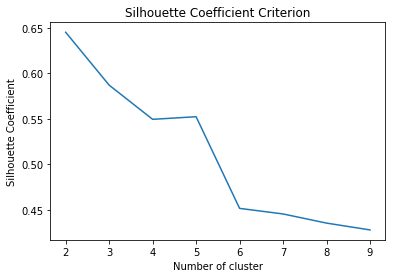

In [ ]:
plt.plot(sil_coeff_x, sil_coeff_y)
plt.xlabel("Number of cluster")
plt.ylabel("Silhouette Coefficient")
plt.title("Silhouette Coefficient Criterion")

#### Run k=4

In [ ]:
k_clusters = 4
kmeans = KMeans( init = "k-means++",n_clusters = k_clusters, n_init = 20, max_iter = 1000).fit(X)
df_ml['cluster'] = kmeans.labels_

#### Explore results

In [ ]:
df_ml.groupby('cluster').count()

,borough,neighborhood,zip_code,latitude,longitude,density,median_house_value,median_age,avg_household_size,avg_wage,perc_pop_positive_covid19,nb_venue_medical_center,nb_venue_arts_entertainment,nb_venue_outdoors_recreation,nb_venue_shop_service
cluster,,,,,,,,,,,,,,,
0,95,95,95,95,95,95,95,95,95,95,95,95,95,95,95
1,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7
2,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21
3,51,51,51,51,51,51,51,51,51,51,51,51,51,51,51


In [ ]:
df_ml.groupby('cluster').mean()

,zip_code,latitude,longitude,density,median_house_value,median_age,avg_household_size,avg_wage,perc_pop_positive_covid19,nb_venue_medical_center,nb_venue_arts_entertainment,nb_venue_outdoors_recreation,nb_venue_shop_service
cluster,,,,,,,,,,,,,
0,10889.052632,40.737247,-73.885442,37105.852632,4.722177e+05,37.887368,2.924211,43482.347368,0.018864,19.652632,7.873684,16.989474,37.600000
1,10018.571429,40.755556,-73.983189,63877.857143,1.801414e+06,36.985714,2.042857,234016.142857,0.006743,43.714286,42.857143,45.000000,49.714286
2,10380.952381,40.728722,-73.981210,77567.666667,1.122036e+06,37.709524,2.004762,146254.142857,0.008834,40.238095,43.714286,45.714286,49.238095
3,10968.372549,40.696973,-73.938740,45735.882353,7.655547e+05,37.186275,2.696078,57735.529412,0.013229,27.215686,20.960784,27.568627,41.333333


In [ ]:
df_ml.head()

,borough,neighborhood,zip_code,latitude,longitude,density,median_house_value,median_age,avg_household_size,avg_wage,perc_pop_positive_covid19,nb_venue_medical_center,nb_venue_arts_entertainment,nb_venue_outdoors_recreation,nb_venue_shop_service,cluster
0,Manhattan,Chelsea and Clinton,10001,40.750742,-73.996530,39102.0,399889.0,35.6,1.9,118909.0,0.010972,38.0,46.0,49.0,50.0,0
1,Manhattan,Lower East Side,10002,40.717040,-73.987000,89911.0,721285.0,42.1,2.3,42766.0,0.009214,42.0,50.0,48.0,50.0,3
2,Manhattan,Lower East Side,10003,40.732509,-73.989350,96874.0,1108917.0,32.9,1.7,148545.0,0.006318,50.0,48.0,48.0,50.0,2
3,Manhattan,Lower Manhattan,10004,40.862612,-73.925379,5419.0,1796465.0,35.9,1.9,246647.0,0.008568,33.0,25.0,35.0,48.0,1
4,Manhattan,Lower Manhattan,10005,40.706019,-74.008580,119790.0,1680524.0,30.4,2.1,215824.0,0.005247,40.0,47.0,48.0,50.0,1


In [ ]:
# set color scheme for the clusters
x = np.arange(k_clusters)
ys = [i + x + (i*x)**2 for i in range(k_clusters)]
rainbow = ['#3554ee','#42ee27','#a96f56','#8c26f6']

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(df_ml['latitude'], df_ml['longitude'], df_ml['neighborhood'], df_ml['cluster']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(NYC_map)
       
NYC_map